# Step 1: Import Libraries 

In [3]:
import pandas as pd #data manipulation
import numpy as np #handles missing data

# Step 2: Load Data Set

In [4]:
file_path = "AEP_hourly.csv"
d = pd.read_csv(file_path)


#### Data Preview 

In [5]:
d

,Datetime,AEP_MW
0,2004-12-31 01:00:00,13478.0
1,2004-12-31 02:00:00,12865.0
2,2004-12-31 03:00:00,12577.0
3,2004-12-31 04:00:00,12517.0
4,2004-12-31 05:00:00,12670.0
...,...,...
121268,2018-01-01 20:00:00,21089.0
121269,2018-01-01 21:00:00,20999.0
121270,2018-01-01 22:00:00,20820.0
121271,2018-01-01 23:00:00,20415.0


# Step 3: Inspect the Data

#### Data Set Info:

In [6]:
print(d.info())


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 121273 entries, 0 to 121272
Data columns (total 2 columns):
 #   Column    Non-Null Count   Dtype  
---  ------    --------------   -----  
 0   Datetime  121273 non-null  object 
 1   AEP_MW    121273 non-null  float64
dtypes: float64(1), object(1)
memory usage: 1.9+ MB
None


#### Missing Values Check

In [7]:
print(d.isnull().sum())

Datetime    0
AEP_MW      0
dtype: int64


#### Duplicates Check

In [8]:
duplicate = d.duplicated().sum()
print(f"\n Number of Duplicates: {duplicate}")

#drops data 
d = d.drop_duplicates()

print(f"\n Number of Duplicates Remaining: {d.duplicated().sum()}")


 Number of Duplicates: 0

 Number of Duplicates Remaining: 0


# Step 4: Outliers and Anomalies 

#### Calculate interquartile range 

In [9]:
raw_data = pd.read_csv(file_path)
data = raw_data.copy()

#bounds 

q1 = d["AEP_MW"].quantile(0.25)
q3 = d["AEP_MW"].quantile(0.75)

iqr = q3 - q1 

low_bound = q1 - 1.5 * iqr
up_bound = q3 + 1.5 * iqr 


#### Filter anomalies - clean data

In [10]:
d = d[(data["AEP_MW"] >= low_bound) & (data["AEP_MW"]<= up_bound)]
# verification 

print("\n Outliers removed!")


 Outliers removed!


#### Cleaned Data Set

In [11]:
cleaned_fp = "clean_d.csv"
d.to_csv(cleaned_fp, index=False)

print(f"\n Cleaned Data saved to: {cleaned_fp}")


 Cleaned Data saved to: clean_d.csv


# Step 5: Visualition of Data

In [12]:
pip install plotly

Note: you may need to restart the kernel to use updated packages.


import plotly 
print(plotly.__file__)


### Raw Data

#### Histogram

In [13]:
import plotly.express as px 

figure = px.histogram(
    raw_data, 
    x = "AEP_MW", 
    nbins=30, 
    title = "Hourly Energy Consumption Distibution (Raw Data)",
    labels = {"AEP_MW": "Energy Consumption"},
    color_discrete_sequence = ["#636EFA"]

)


figure.update_layout(
    xaxis_title = "Energy Consumption",
    yaxis_title = "Frequency",
    title_font = dict(size = 20, color = "white"),
    template = "plotly_dark"
) 


figure.show()


#### Line Graph 

In [14]:
## energy consumption against time

raw_data["Datetime"] = pd.to_datetime(raw_data["Datetime"])

## group data by date and sum total amount 

energy_trend = raw_data.groupby("Datetime")["AEP_MW"].sum().reset_index()

#line chart

figure = px.line(
    energy_trend, 
    x="Datetime",
    y="AEP_MW",
    title = "Energy Consumption Vs Time",
    line_shape = "spline", 
    color_discrete_sequence = ["#AB63FA"]
)

figure.update_layout(
    xaxis_title = "Date",
    yaxis_title = "Energy Consumption",
    title_font = dict(size = 20, color = "black"),
    template = "plotly_white"

)

figure.update_xaxes(
    rangeselector = dict(
        buttons = list([
            dict(count = 7, label = " Week", step = "day", stepmode = "backward"),
            dict(count = 1, label = "Month", step = "month", stepmode = "backward"),
            dict(step = "year")
        ])
    ),
    rangeslider=dict(visible=True),
    type="date"
)
                      
figure.show()                    
                                      

#### Cleaned Data 

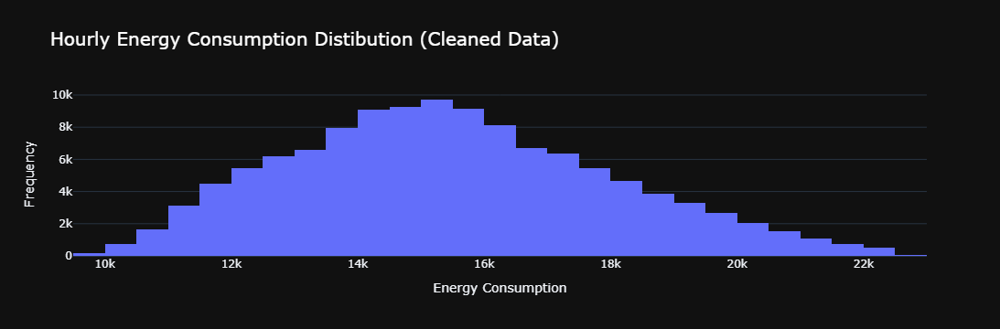

In [15]:
import plotly.express as px 

#create histogram

figure = px.histogram(
    d, 
    x = "AEP_MW", 
    nbins=30, 
    title = "Hourly Energy Consumption Distibution (Cleaned Data)",
    labels = {"AEP_MW": "Energy Consumption"},
    color_discrete_sequence = ["#636EFA"]

)


figure.update_layout(
    xaxis_title = "Energy Consumption",
    yaxis_title = "Frequency",
    title_font = dict(size = 20, color = "white"),
    template = "plotly_dark"
) 


figure.show()


## Step 6: Split Data into Test Sets

In [16]:
d.describe()

,AEP_MW
count,120606.000000
mean,15456.672578
std,2533.155917
min,9581.000000
25%,13620.000000
50%,15292.000000
75%,17161.000000
max,22554.000000


In [112]:
#import model selection modules 
## these will be compared 
from sklearn.linear_model import LinearRegression # for the model
from sklearn.neural_network import MLPRegressor ## For multilayer perceptron regressor - type of neural network 
from sklearn.ensemble import RandomForestRegressor 

from sklearn.metrics import r2_score # the eluation metric 


 

### Instantiate Models 
#### Creates an instance of the model

In [113]:
modelLR = LinearRegression()
# have deault hyper parameters, whih affect how they perform 

### Train Test Split 
#### Puts data  in groups that are going to be tested and trained 

In [19]:
d.head()

,Datetime,AEP_MW
0,2004-12-31 01:00:00,13478.0
1,2004-12-31 02:00:00,12865.0
2,2004-12-31 03:00:00,12577.0
3,2004-12-31 04:00:00,12517.0
4,2004-12-31 05:00:00,12670.0


#### Converting from strings to floats

In [114]:
#converted dateandtime to a float value 

d["Datetime"] = pd.to_datetime(d["Datetime"])

d["year"] = d["Datetime"].dt.year
d["month"] = d["Datetime"].dt.month
d["day"] = d["Datetime"].dt.day
d["hour"] = d["Datetime"].dt.hour
d["dayofweek"] = d["Datetime"].dt.dayofweek # moday = 0 and Sunday = 6
d['weekofyear'] = d['Datetime'].dt.isocalendar().week
d['is_weekend'] = d['dayofweek'].isin([5,6]).astype(int) ## data is cyclical - see models above 



#### Checking Types 

In [115]:
print(d.dtypes)

Datetime       datetime64[ns]
AEP_MW                float64
Dateime        datetime64[ns]
year                    int32
month                   int32
day                     int32
hour                    int32
dayofweek               int32
weekofyear             UInt32
is_weekend              int64
hour_sin              float64
hour_cos              float64
dow_sin               float64
dow_cos               float64
month_sin             float64
month_cos             float64
lag_1h                float64
lag_24h               float64
rolling_24h           float64
lag_168               float64
dtype: object


### We convert to sine and cosine values to help model to understand that there is a cyclical nature within the data set (i.e. hour 23 and hour 0 are adjacent)

In [67]:
# use sine and cosine transforms 
# Hour of day
d['hour_sin'] = np.sin(2 * np.pi * d['hour']/24)
d['hour_cos'] = np.cos(2 * np.pi * d['hour']/24)

# Day of week
d['dow_sin'] = np.sin(2 * np.pi * d['dayofweek']/7)
d['dow_cos'] = np.cos(2 * np.pi * d['dayofweek']/7)

# Month of year
d['month_sin'] = np.sin(2 * np.pi * d['month']/12)
d['month_cos'] = np.cos(2 * np.pi * d['month']/12)
## this helps show that hour 23 and 0 are adjacent 

In [126]:
# introduce a lag feature to give model temporal context an memory of the past values 

# Lag of 1 hour - 
d['lag_1h'] = d['AEP_MW'].shift(1)

# Lag of 24 hours (same hour yesterday)
d['lag_24h'] = d['AEP_MW'].shift(24)

# for 7 days 
d['lag_168'] = d['AEP_MW'].shift(168)


In [127]:
print(d.isna().sum())
#checking for missing values 

Datetime         0
AEP_MW           0
Dateime          0
year             0
month            0
day              0
hour             0
dayofweek        0
weekofyear       0
is_weekend       0
hour_sin         0
hour_cos         0
dow_sin          0
dow_cos          0
month_sin        0
month_cos        0
lag_1h           1
lag_24h         24
rolling_24h      0
lag_168        168
dtype: int64


In [128]:
# Drop any rows with NaN due to lag/rolling features
d.dropna(inplace=True)

print(d.isna().sum())


Datetime       0
AEP_MW         0
Dateime        0
year           0
month          0
day            0
hour           0
dayofweek      0
weekofyear     0
is_weekend     0
hour_sin       0
hour_cos       0
dow_sin        0
dow_cos        0
month_sin      0
month_cos      0
lag_1h         0
lag_24h        0
rolling_24h    0
lag_168        0
dtype: int64


In [129]:
# Check the new features
print(d.head())

               Datetime   AEP_MW             Dateime  year  month  day  hour  \
529 2004-12-09 02:00:00  14036.0 2004-12-09 02:00:00  2004     12    9     2   
530 2004-12-09 03:00:00  13918.0 2004-12-09 03:00:00  2004     12    9     3   
531 2004-12-09 04:00:00  13839.0 2004-12-09 04:00:00  2004     12    9     4   
532 2004-12-09 05:00:00  14140.0 2004-12-09 05:00:00  2004     12    9     5   
533 2004-12-09 06:00:00  14968.0 2004-12-09 06:00:00  2004     12    9     6   

     dayofweek  weekofyear  is_weekend  hour_sin      hour_cos   dow_sin  \
529          3          50           0  0.500000  8.660254e-01  0.433884   
530          3          50           0  0.707107  7.071068e-01  0.433884   
531          3          50           0  0.866025  5.000000e-01  0.433884   
532          3          50           0  0.965926  2.588190e-01  0.433884   
533          3          50           0  1.000000  6.123234e-17  0.433884   

      dow_cos     month_sin  month_cos   lag_1h  lag_24h   rol

## Split data into test and train sets by year

In [130]:
train = d[d['Datetime'].dt.year < 2018] ## training set are all years before 2018
test = d[d['Datetime'].dt.year == 2018] ## 2018 will be the test set 


In [153]:
# Features (X)

features = ['hour_sin', 'hour_cos', 'dow_sin', 'dow_cos', 'lag_1h', 'lag_24h', 'lag_168']

X_train = train[features] #2D table where rows is the sampl and cols are the features
y_train = train['AEP_MW'] # 1D series: target load for training
X_test = test[features]
y_test = test['AEP_MW'] 



In [147]:
d['Time'] = np.arange(len(d.index))

d.head()

,AEP_MW,Dateime,year,month,day,hour,dayofweek,weekofyear,is_weekend,hour_sin,...,dow_sin,dow_cos,month_sin,month_cos,lag_1h,lag_24h,rolling_24h,lag_168,Datetime,Time
Datetime,,,,,,,,,,,,,,,,,,,,,
2004-10-01 01:00:00,12379.0,2004-10-01 01:00:00,2004.0,10.0,1.0,1.0,4.0,40.0,0.0,0.258819,...,-0.433884,-0.900969,-0.866025,0.5,12172.0,12260.0,12964.208333,12468.0,0,0
2004-10-01 02:00:00,11935.0,2004-10-01 02:00:00,2004.0,10.0,1.0,2.0,4.0,40.0,0.0,0.500000,...,-0.433884,-0.900969,-0.866025,0.5,12379.0,11672.0,12975.166667,12046.0,1,1
2004-10-01 03:00:00,11692.0,2004-10-01 03:00:00,2004.0,10.0,1.0,3.0,4.0,40.0,0.0,0.707107,...,-0.433884,-0.900969,-0.866025,0.5,11935.0,11352.0,12989.333333,11749.0,2,2
2004-10-01 04:00:00,11597.0,2004-10-01 04:00:00,2004.0,10.0,1.0,4.0,4.0,40.0,0.0,0.866025,...,-0.433884,-0.900969,-0.866025,0.5,11692.0,11177.0,13006.833333,11784.0,3,3
2004-10-01 05:00:00,11681.0,2004-10-01 05:00:00,2004.0,10.0,1.0,5.0,4.0,40.0,0.0,0.965926,...,-0.433884,-0.900969,-0.866025,0.5,11597.0,11142.0,13029.291667,11919.0,4,4


In [132]:
model = LinearRegression()
model.fit(X_train, y_train) # fits model parameters to minimize r squaed error in the training set

LinearRegression()

In [133]:
y_pred = model.predict(X_test) 
# used to predict loads in 2018

## Error Prediction accuracy after feature engineering 

In [134]:
print("R² Score:", r2_score(y_test, y_pred)) # ealuates accuracy 


R² Score: 0.9609149070390977


# Step 7: Plotting the model

In [135]:
import matplotlib.pyplot as plt

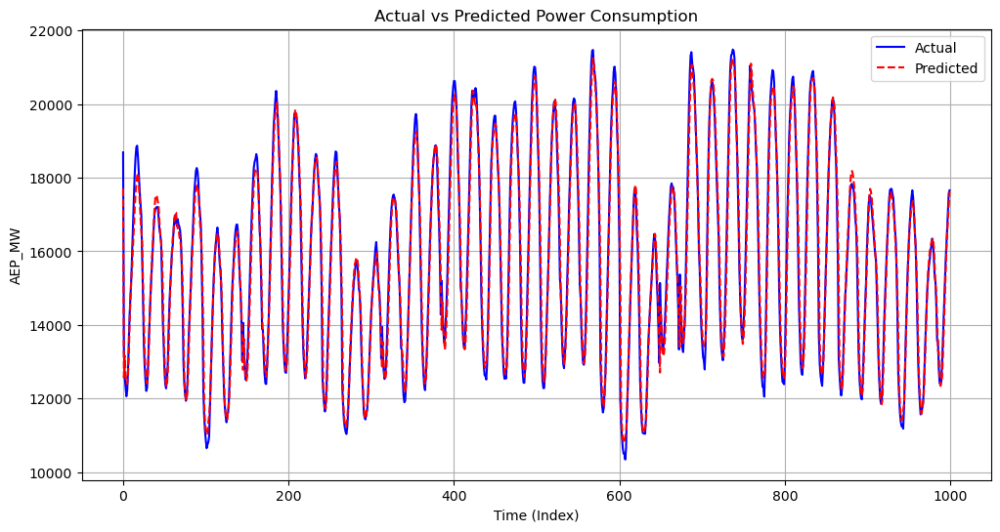

In [154]:


# Plot actual vs predicted for the test set
plt.figure(figsize=(12, 6))

# Plot actual values (y_test)
plt.plot(y_test.values[:1000], label='Actual', color='blue')  # First 1000 points for clarity

# Plot predicted values (y_pred)
plt.plot(y_pred[:1000], label='Predicted', color='red', linestyle='dashed')

plt.title('Actual vs Predicted Power Consumption')
plt.xlabel('Time (Index)')
plt.ylabel('AEP_MW')
plt.legend()
plt.grid(True)
plt.show()
